In [1]:
import os
import subprocess
from tqdm import tqdm
import glob
import argparse
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from PIL import Image

In [6]:
from deepface import DeepFace

In [2]:
# CHANGE THIS DIRECTORY TO WHERE TEXTURES ARE
candidate_directory = '/projectnb/sparkgrp/ml-atfal-mafkoda-grp/candidate_repository/'
# CHANGE THIS DIRECTORY TO NEW SET OF IMAGES FOR STRUCTURE
image_directory = '/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/'
# CHANGE THIS TO OUTPUT FILE NAME FOR DEEPFACE MODEL
output_file_name = 'matches_euclidianl2.csv'
# CHANGE THIS TO OUTPUT FILE NAME FOR PARSED DEEPFACE MODEL OUTPUT
parsed_output_file_name = 'parsed_matches_euclidianl2.csv'

In [8]:
class FaceRecognition:
    def __init__(self, missing_dir, unknown_dir, output_path, model='VGG-Face', metric='euclidean_l2', detector_backend='mtcnn'):
        # Initialize the FaceRecognition class with directories, output path, model, metric, and detector backend
        self.missing_dir = missing_dir  # Directory of missing persons' images
        self.unknown_dir = unknown_dir  # Directory of unknown persons' images
        self.output_path = output_path  # Path for the output CSV file
        self.model = model  # Face recognition model
        self.metric = metric  # Distance metric for comparison
        self.detector_backend = detector_backend  # Backend for face detection
        # self.metric_col = self.model + "_" + self.metric  # Column name for metric in the output DataFrame

    def detect_and_match_faces(self):
        # Detect and match faces in images from the missing directory
        image_paths = glob.glob(os.path.join(self.missing_dir, "*"))  # Get all image paths
        results = []  # List to store the results

        for path in image_paths:
            # Check the file extension
            ext = os.path.splitext(path)[1].lower()
            if ext in [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"]:
                # Extract faces from the image
                detected_img_objs = DeepFace.extract_faces(path, enforce_detection=True, detector_backend=self.detector_backend)
                
                if detected_img_objs:
                    # Find matches in the unknown directory using DeepFace
                    dfs_list = DeepFace.find(
                        img_path=path,
                        db_path=self.unknown_dir, 
                        model_name=self.model,
                        distance_metric=self.metric,
                        enforce_detection=False,
                        detector_backend=self.detector_backend
                    )

                    dfs = dfs_list[0]

                    
                    dfs['identity'] = dfs['identity'].str.split('/').str.get(-1)
                    print(dfs.head())

                    # Check if the DataFrame is not empty and append the results
                    if not dfs.empty:
                        matched_filenames = ', '.join(dfs['identity'].tolist())
                        print(matched_filenames)
                        # metric_values = ', '.join(map(str, dfs[self.metric_col].tolist()))

                        results.append({
                            'missing_filename': path,
                            'unknowns_matched_filenames': matched_filenames,
                            'distance': dfs['distance']
                        })

        df = pd.DataFrame(results)  # Create DataFrame from results
        df.to_csv(self.output_path, index=False)  # Save the results to a CSV file

def parse_args():
    # Define command line arguments for the script
    parser = argparse.ArgumentParser(description='Face recognition')
    parser.add_argument('--model', type=str, default='VGG-Face', help='Model to use for Face Recognition')
    parser.add_argument('--metric', type=str, default='euclidean_l2', help='Metrics to use for Face Recognition')
    parser.add_argument('--missing_dir', required=True, type=str, help='Directory containing images of missing persons')
    parser.add_argument('--unknown_dir', required=True, type=str, help='Directory containing images of unknown persons')
    parser.add_argument('--output_path', required=True, type=str, help='Path to the output CSV file')
    parser.add_argument('--detector_backend', type=str, default='mtcnn', help='Detector backend to use')
    return parser.parse_args()

if __name__ == '__main__':
    fr = FaceRecognition(
        missing_dir=candidate_directory,
        unknown_dir=image_directory,
        output_path=output_file_name
    )
    fr.detect_and_match_faces()


1/1 [==============================] - 0s 426ms/step
24-04-10 19:26:32 - Found 1 newly added image(s), 0 removed image(s), 0 replaced image(s).


Finding representations:   0%|          | 0/1 [00:00<?, ?it/s]

1/1 [==============================] - 0s 16ms/step


Finding representations: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

24-04-10 19:26:33 - There are now 453 representations in ds_vggface_mtcnn_v2.pkl
24-04-10 19:26:33 - Searching /projectnb/sparkgrp/ml-atfal-mafkoda-grp/candidate_repository/reunited_image_181.png in 453 length datastore
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step
24-04-10 19:26:33 - find function duration 4.016902685165405 seconds
                 identity                                      hash  target_x  \
0  reunited_image_494.png  d739b86ee08e1d76da09b8ca32b88d55be8f860f        13   
1  reunited_image_482.png  cb893a98848cf80942a09b1a35f1c6b7df1c3dfb        30   
2  john_doe_image_467.png  6c88a7a1be998f61e5902c1c0998aa9f90e1e83f        23   

   target_y  target_w  target_h  source_x  source_y  source_w  source_h  \
0        28        97       123        18        56       164       210   
1       106       251       341        18        56       164       210   
2        45       172       239        18        56       164       210   

   threshold  distance  
0       1.17  1.111458  
1       1.17  1.160637  
2       1.17  1.161788  
reunited_image_494.png, reunited_image_482.png, john_doe_image_467.png
1/1 [==============================] - 0s 17ms/step
24-04-10 19:26:34 - Searching 

In [3]:
df = pd.read_csv(output_file_name)

for index, row in df.iterrows():
    # Split the 'unknowns_matched_filenames' column by commas and convert to list
    row['unknowns_matched_filenames'] = row['unknowns_matched_filenames'].split(', ')
    row['missing_filename'] = row['missing_filename'].split('/')[-1]
    
    # Convert the 'distance' column to a list
    data = row['distance']
 
    datapoints = data.split('\n')
    if float(datapoints[0].split()[1]) < 0.001:
        try:
            value = float(datapoints[1].split()[1])
            df.loc[index, 'best_match'] = row['unknowns_matched_filenames'][1]
            df.loc[index, 'valid_found'] = True
        except ValueError:
            df.loc[index, 'valid_found'] = False
            df.loc[index, 'best_match'] = row['missing_filename']
    else:
        df.loc[index, 'best_match'] = row['unknowns_matched_filenames'][0]
        df.loc[index, 'valid_found'] = True
        
df.to_csv(parsed_output_file_name, index=False)

In [4]:
print(df)

          missing_filename                         unknowns_matched_filenames  \
0   reunited_image_181.png  [reunited_image_494.png, reunited_image_482.pn...   
1   reunited_image_384.png    [john_doe_image_13.png, john_doe_image_442.png]   
2   reunited_image_158.png  [reunited_image_140.png, john_doe_image_13.png...   
3    john_doe_image_13.png  [john_doe_image_13.png, john_doe_image_442.png...   
4   reunited_image_375.png  [john_doe_image_333.png, reunited_image_140.pn...   
..                     ...                                                ...   
65  reunited_image_100.png                           [reunited_image_100.png]   
66  reunited_image_458.png  [reunited_image_458.png, reunited_image_460.pn...   
67  reunited_image_455.png   [reunited_image_455.png, reunited_image_670.png]   
68  john_doe_image_467.png  [john_doe_image_467.png, reunited_image_121.pn...   
69  reunited_image_236.png  [reunited_image_236.png, reunited_image_114.pn...   

                           

In [7]:
os.chdir("/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch")
for index, row in tqdm(df.iterrows(), total=len(df)):
    
    missing_filename = row['missing_filename'] 
    input_structure_image = image_directory + missing_filename
    directory_exists = os.path.exists(os.path.dirname(input_structure_image))
    best_match_filename = row['best_match']
    input_texture_image = image_directory + best_match_filename
    directory_exists = os.path.exists(os.path.dirname(input_texture_image)) and directory_exists
    if not directory_exists or not row['valid_found']:
        print("Missing person's file not found or no valid candidate image found!")
    else:
        command = [
            "python",
            "-m",
            "experiments",
            "ffhq512_pretrained",
            "test",
            "simple_interpolation",
            "--input_structure_image",
            input_structure_image,
            "--input_texture_image",
            input_texture_image
        ]
        
        try:
            subprocess.run(command, check=True)
        except subprocess.CalledProcessError as e:
            print(f"Error executing command: {e}")

  0%|          | 0/70 [00:00<?, ?it/s]/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.


Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_port: 2004                          
               easy_label:         

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_181.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_494.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_384.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_158.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_140.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

  6%|▌         | 4/70 [00:29<07:54,  7.19s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_375.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_333.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_750.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_84.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_526.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_301.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_49.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_434.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 38, in evaluate
    structure_image = self.load_image(self.opt.input_structure_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errn

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_17.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_183.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 14%|█▍        | 10/70 [01:09<07:13,  7.22s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_178.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_495.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 16%|█▌        | 11/70 [01:21<08:17,  8.44s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_273.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_184.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 17%|█▋        | 12/70 [01:29<08:10,  8.46s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_87.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_613.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 19%|█▊        | 13/70 [01:37<07:59,  8.41s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_593.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_393.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 20%|██        | 14/70 [01:45<07:40,  8.23s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_161.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_293.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 21%|██▏       | 15/70 [01:54<07:36,  8.30s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_471.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_676.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 23%|██▎       | 16/70 [02:02<07:29,  8.33s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_340.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_167.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 24%|██▍       | 17/70 [02:11<07:31,  8.51s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_550.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 
Missing person's file not found or no valid candidate image found!


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 27%|██▋       | 19/70 [02:22<06:06,  7.19s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_32.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_606.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 29%|██▊       | 20/70 [02:30<06:10,  7.40s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_358.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_122.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 30%|███       | 21/70 [02:39<06:14,  7.64s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 31%|███▏      | 22/70 [02:47<06:16,  7.85s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_715.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_65.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 
Missing person's file not found or no valid candidate image found!


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 34%|███▍      | 24/70 [02:56<04:50,  6.31s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_305.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_606.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 36%|███▌      | 25/70 [03:04<05:03,  6.73s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_611.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_727.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

Traceback (most recent call last):
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/test.py", line 13, in <module>
    evaluators.evaluate(model, dataset, opt.resume_iter)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/group_evaluator.py", line 66, in evaluate
    new_metrics = evaluator.evaluate(model, dataset, nsteps)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 39, in evaluate
    texture_image = self.load_image(self.opt.input_texture_image)
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/evaluation/simple_swapping_evaluator.py", line 32, in load_image
    img = Image.open(path).convert('RGB')
  File "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/site-packages/PIL/Image.py", line 3247, in open
    fp = builtins.open(filename, "rb")
FileNotFoundError: [Errno 2]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_163.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_779-checkpoint.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 39%|███▊      | 27/70 [03:19<05:04,  7.08s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_251.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_759.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 40%|████      | 28/70 [03:30<05:47,  8.26s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_184.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_273.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 41%|████▏     | 29/70 [03:39<05:46,  8.46s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_352.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_221.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 43%|████▎     | 30/70 [03:48<05:41,  8.53s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_140.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 44%|████▍     | 31/70 [03:56<05:31,  8.49s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_333.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 46%|████▌     | 32/70 [04:05<05:23,  8.51s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_150.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_218.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 47%|████▋     | 33/70 [04:14<05:20,  8.65s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_420.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_355.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.


Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_port: 2004                          
               easy_label:         

 49%|████▊     | 34/70 [04:22<05:07,  8.54s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_556.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_370.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 50%|█████     | 35/70 [04:33<05:23,  9.23s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_692.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_135.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 51%|█████▏    | 36/70 [04:41<05:08,  9.07s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_25.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_592.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 53%|█████▎    | 37/70 [04:50<04:50,  8.80s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_135.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_421.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 
Missing person's file not found or no valid candidate image found!


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 56%|█████▌    | 39/70 [04:58<03:25,  6.61s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_339.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_87.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 57%|█████▋    | 40/70 [05:06<03:29,  6.97s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_651.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_332.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 59%|█████▊    | 41/70 [05:14<03:35,  7.44s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_754.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_202.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 60%|██████    | 42/70 [05:23<03:35,  7.71s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_217.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_306.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 61%|██████▏   | 43/70 [05:34<03:53,  8.65s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_75.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 63%|██████▎   | 44/70 [05:42<03:40,  8.49s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_504.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_655.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 64%|██████▍   | 45/70 [05:50<03:27,  8.29s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_152.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_274.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 66%|██████▌   | 46/70 [05:58<03:17,  8.24s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_275.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 67%|██████▋   | 47/70 [06:06<03:08,  8.18s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_500.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 69%|██████▊   | 48/70 [06:14<02:59,  8.18s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_114.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 70%|███████   | 49/70 [06:22<02:49,  8.07s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_313.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_232.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 71%|███████▏  | 50/70 [06:30<02:41,  8.08s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_714.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_560.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 73%|███████▎  | 51/70 [06:39<02:39,  8.37s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_227.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_374.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 
Missing person's file not found or no valid candidate image found!


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 76%|███████▌  | 53/70 [06:47<01:47,  6.32s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_374.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_227.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 77%|███████▋  | 54/70 [06:55<01:47,  6.70s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_494.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_202.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 79%|███████▊  | 55/70 [07:03<01:44,  6.99s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_198.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_517.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 80%|████████  | 56/70 [07:11<01:43,  7.39s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_365.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_749.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 81%|████████▏ | 57/70 [07:19<01:39,  7.66s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_167.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_340.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 
Missing person's file not found or no valid candidate image found!


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 84%|████████▍ | 59/70 [07:28<01:07,  6.12s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_592.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_25.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 86%|████████▌ | 60/70 [07:37<01:07,  6.74s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_51.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_482.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.


Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_port: 2004                          
               easy_label:         

 87%|████████▋ | 61/70 [07:47<01:08,  7.60s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_274.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_152.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 89%|████████▊ | 62/70 [07:55<01:01,  7.73s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_379.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_336.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.


Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_port: 2004                          
               easy_label:         

 90%|█████████ | 63/70 [08:03<00:54,  7.86s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_522.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_779.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.


Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_port: 2004                          
               easy_label:         

 91%|█████████▏| 64/70 [08:12<00:49,  8.18s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_701.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_422.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 93%|█████████▎| 65/70 [08:21<00:42,  8.44s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_70.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_571.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 
Missing person's file not found or no valid candidate image found!


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 96%|█████████▌| 67/70 [08:29<00:19,  6.34s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_458.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_460.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 97%|█████████▋| 68/70 [08:36<00:13,  6.70s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_455.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_670.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

 99%|█████████▊| 69/70 [08:44<00:06,  6.97s/it]

CUDA_VISIBLE_DEVICES=1 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_467.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_121.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


/projectnb/sparkgrp/ml-atfal-mafkoda-grp/shared_conda_envs/swap-auto-pytorch/lib/python3.10/runpy.py:126: RuntimeWarning: 'experiments.__main__' found in sys.modules after import of package 'experiments', but prior to execution of 'experiments.__main__'; this may result in unpredictable behaviour
  warn(RuntimeWarning(msg))
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/fused/build.ninja...
Building extension module fused...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)


ninja: no work to do.
Loading custom kernel...
ninja: no work to do.
parsing args...
----------------- Options ---------------
            R1_once_every: 16                            
               batch_size: 1                             
                    beta1: 0.0                           
                    beta2: 0.99                          
          checkpoints_dir: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/	[default: ./checkpoints/]
                crop_size: 512                           	[default: 256]
                 dataroot: .                             	[default: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box]
             dataset_mode: imagefolder                   
              display_env: main                          
             display_freq: 1600                          
            display_ncols: 2                             
             display_por

Loading extension module fused...
Using /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118 as PyTorch extensions root...
Detected CUDA files, patching ldflags
Emitting ninja build file /usr4/cs505ws/simonkye/.cache/torch_extensions/py310_cu118/upfirdn2d/build.ninja...
Building extension module upfirdn2d...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
Loading extension module upfirdn2d...


-------------------StyleGAN2ResnetEncoder---------------------
FromRGB: 0.000M
	Conv: 0.000M
	Act: 0.000M
DownToSpatialCode: 2.526M
	ResBlockDownBy1: 0.030M
	ResBlockDownBy2: 0.119M
	ResBlockDownBy4: 0.476M
	ResBlockDownBy8: 1.901M
ToSpatialCode: 0.267M
	0: 0.263M
	1: 0.004M
DownToGlobalCode: 23.596M
	ConvLayerDownBy16: 4.720M
	ConvLayerDownBy32: 18.876M
ToGlobalCode: 4.196M
	0: 4.196M
[Network 0] Total number of parameters : 30.585 M
-----------------------------------------------

-------------------StyleGAN2ResnetGenerator---------------------
SpatialCodeModulation: 0.033M
	scale: 0.016M
	bias: 0.016M
HeadResnetBlock0: 1.152M
	conv1: 0.035M
	conv2: 1.115M
	skip: 0.002M
HeadResnetBlock1: 5.245M
	conv1: 1.705M
	conv2: 3.409M
	skip: 0.131M
UpsamplingResBlock16: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock32: 6.818M
	conv1: 3.409M
	conv2: 3.409M
	skip: 0.000M
UpsamplingResBlock64: 3.475M
	conv1: 2.229M
	conv2: 1.115M
	skip: 0.131M
UpsamplingResBlock128: 1.262M
	

100%|██████████| 70/70 [08:55<00:00,  7.65s/it]

CUDA_VISIBLE_DEVICES=0 python test.py  --dataroot . --dataset_mode imagefolder --checkpoints_dir /projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/experiments/checkpoints/ --num_gpus 1 --batch_size 1 --preprocess scale_shortside --load_size 512 --crop_size 512 --name ffhq512_pretrained --result_dir ./results/ --evaluation_metrics simple_swapping --input_structure_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_236.png --input_texture_image /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_114.png --texture_mix_alpha 0.0 0.25 0.5 0.75 1.0 


0it [00:00, ?it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_494.png
File not found: reunited_image_181_reunited_image_494_0.00.png


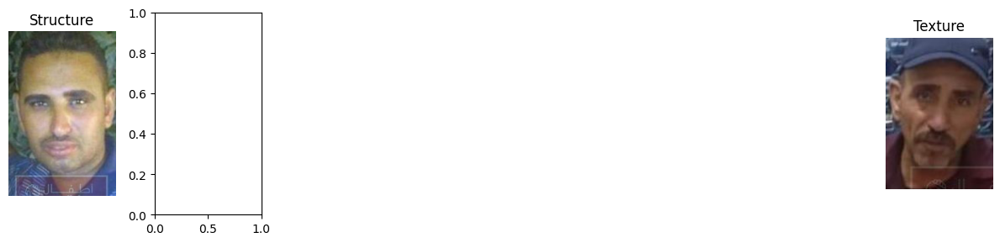

1it [00:00,  4.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png
File not found: reunited_image_384_john_doe_image_13_0.00.png


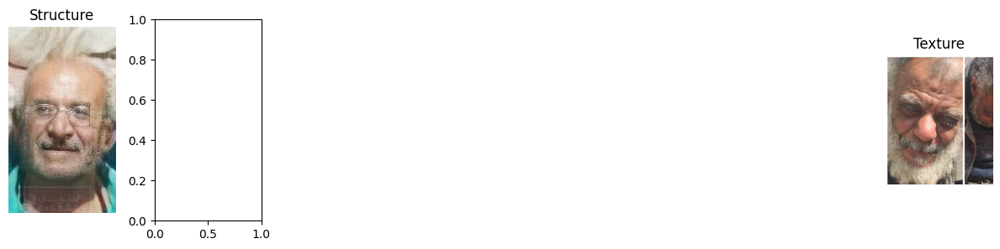

2it [00:00,  4.37it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_140.png
File not found: reunited_image_158_reunited_image_140_0.00.png


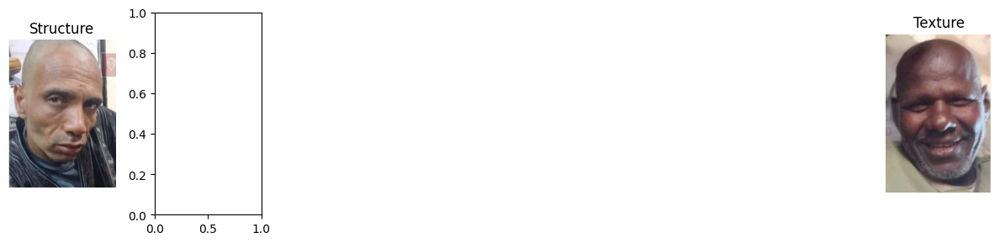

3it [00:00,  4.38it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png


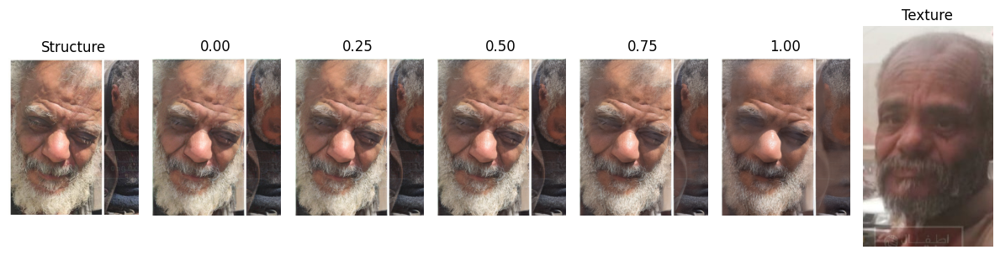

4it [00:01,  2.41it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_333.png
File not found: reunited_image_375_john_doe_image_333_0.00.png


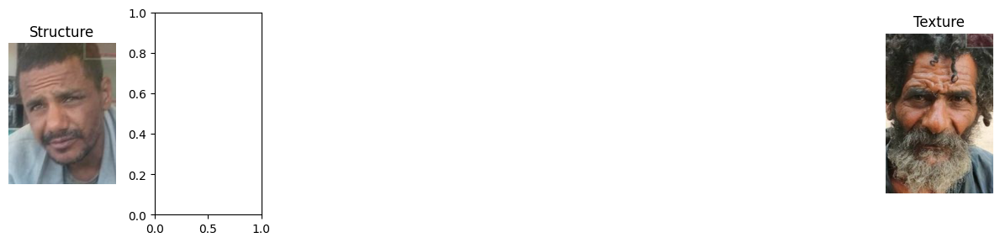

5it [00:01,  2.91it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_84.png
File not found: reunited_image_750_reunited_image_84_0.00.png


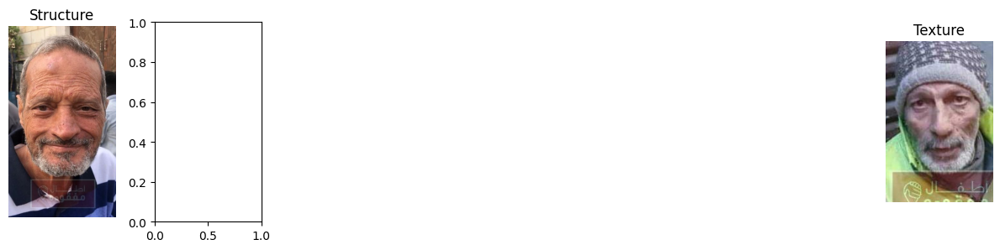

6it [00:01,  3.21it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_301.png
File not found: reunited_image_526_john_doe_image_301_0.00.png


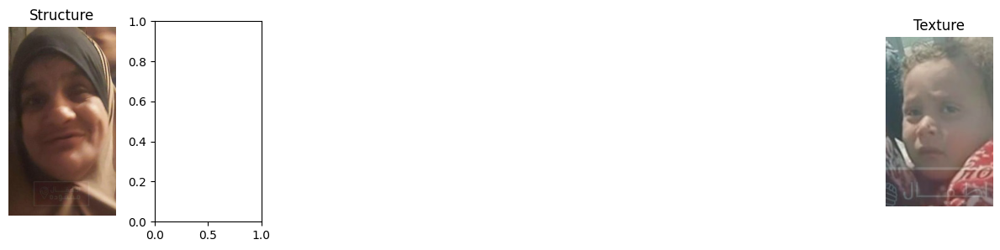

7it [00:02,  3.42it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_434.png
File not found: reunited_image_49_reunited_image_434_0.00.png


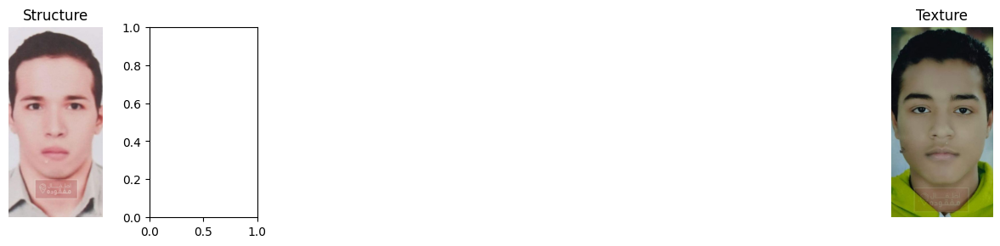

8it [00:02,  3.47it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_183.png
File not found: reunited_image_17_reunited_image_183_0.00.png


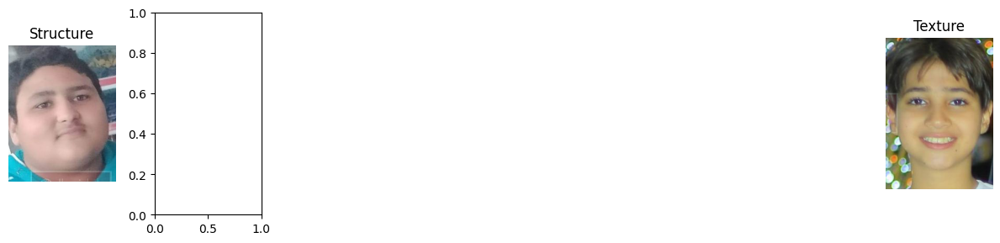

9it [00:02,  3.72it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_495.png


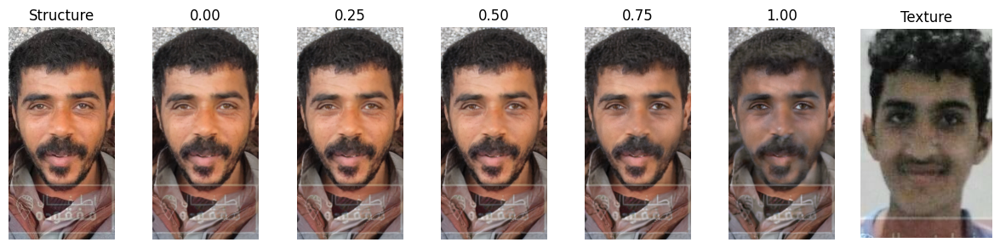

10it [00:03,  2.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_184.png


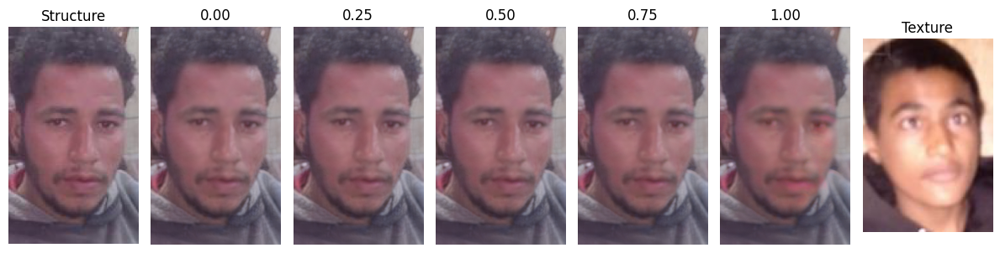

11it [00:04,  1.77it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_613.png


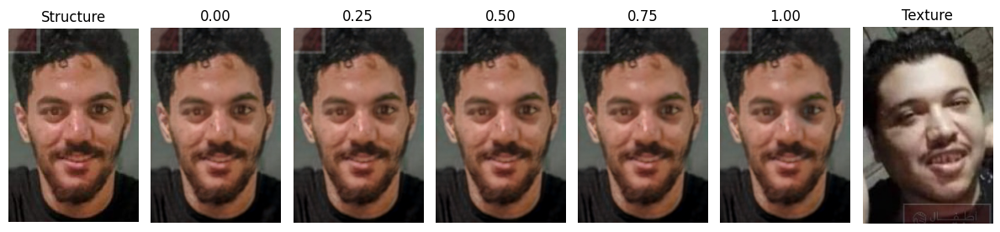

12it [00:05,  1.60it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_393.png


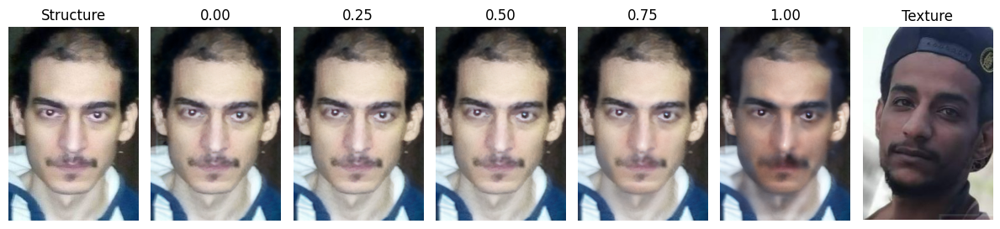

13it [00:05,  1.46it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_293.png


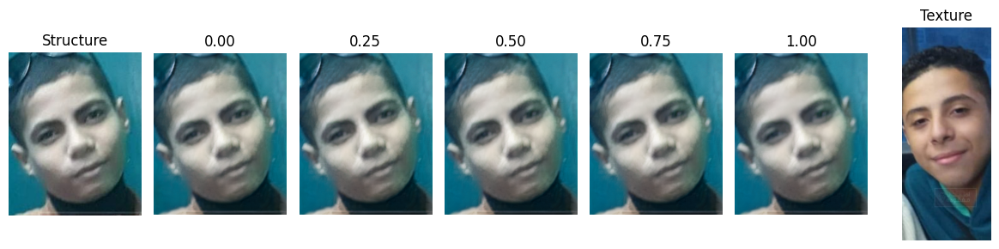

14it [00:06,  1.48it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_676.png


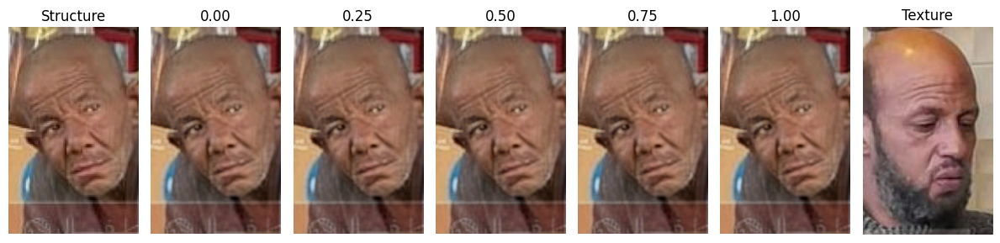

15it [00:07,  1.37it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_167.png


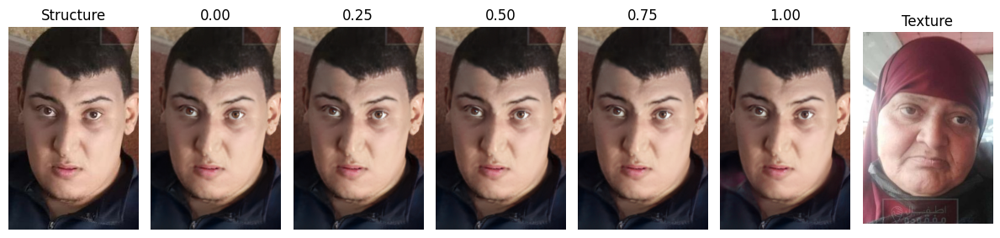

16it [00:08,  1.33it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png


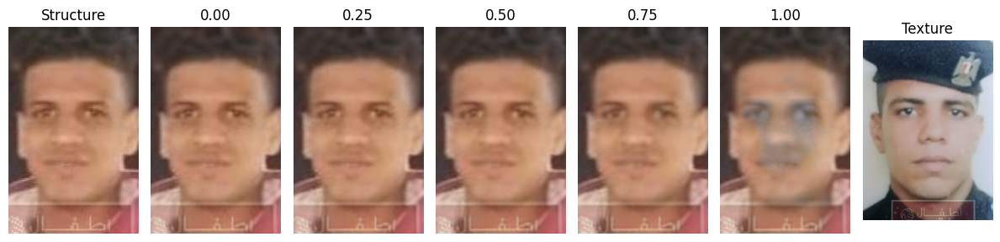

17it [00:08,  1.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_250.png
Missing person's file not found or no valid candidate image found!
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_606.png


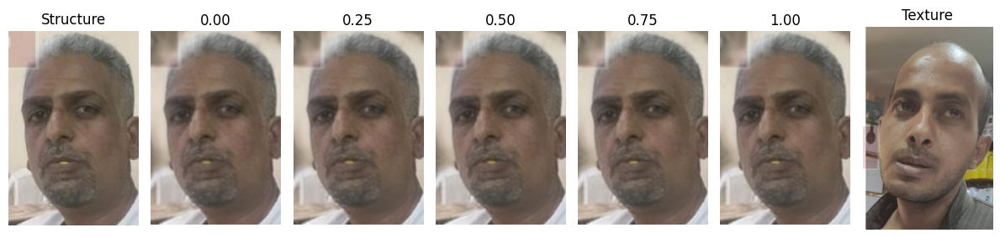

19it [00:09,  1.74it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_122.png


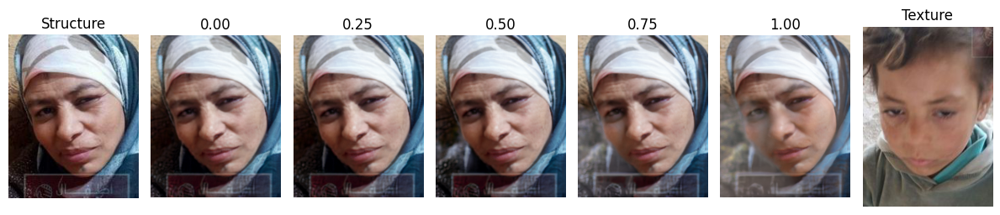

20it [00:10,  1.70it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png


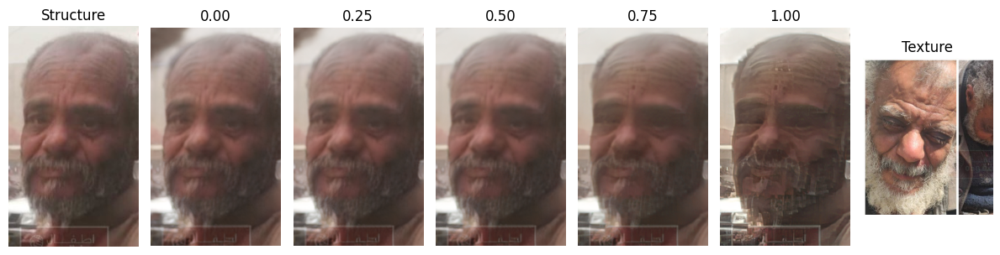

21it [00:11,  1.50it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_65.png


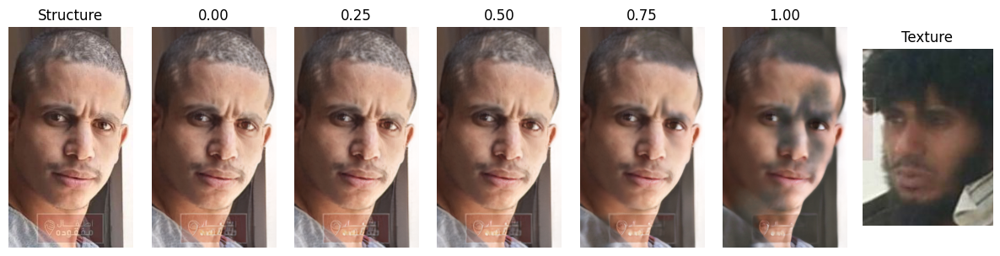

22it [00:11,  1.45it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_297.png
Missing person's file not found or no valid candidate image found!
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_606.png


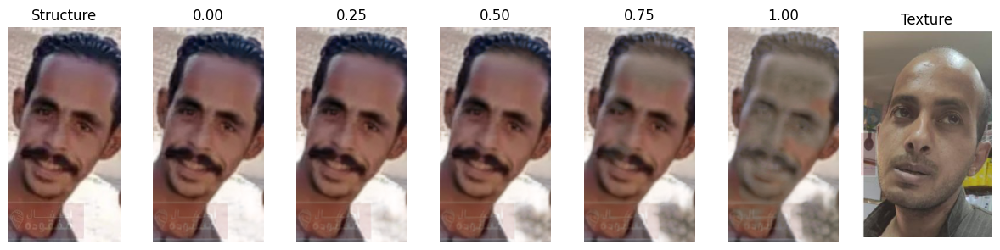

24it [00:12,  1.79it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_727.png


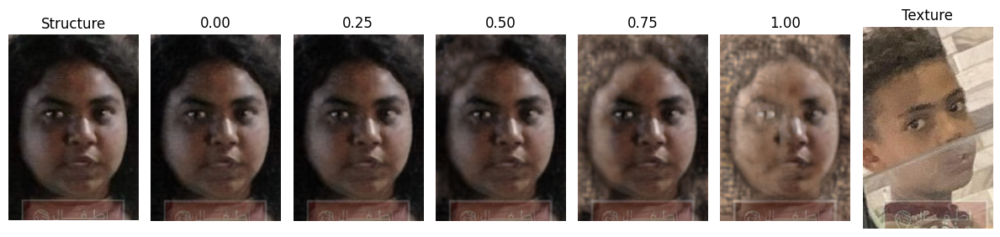

25it [00:13,  1.70it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_779-checkpoint.png
File not found: reunited_image_163_reunited_image_779-checkpoint_0.00.png
File not found: /projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_779-checkpoint.png


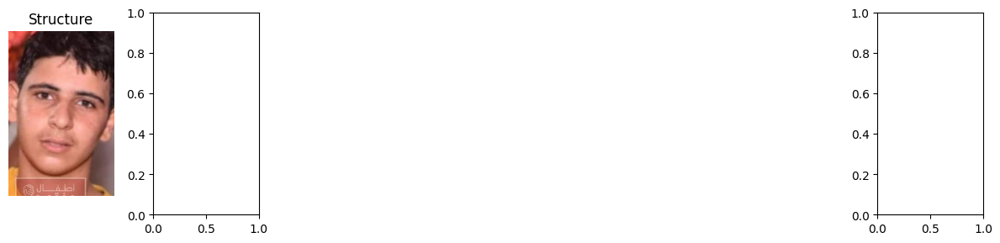

26it [00:13,  1.92it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_759.png


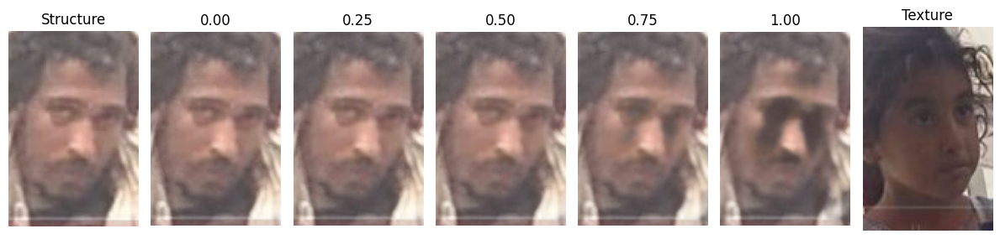

27it [00:14,  1.73it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_273.png


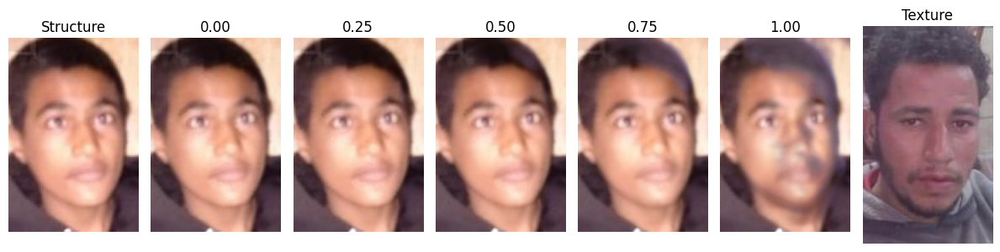

28it [00:15,  1.59it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_221.png


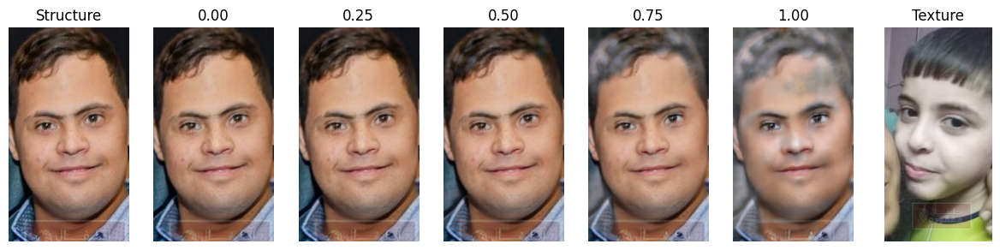

29it [00:15,  1.50it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_442.png


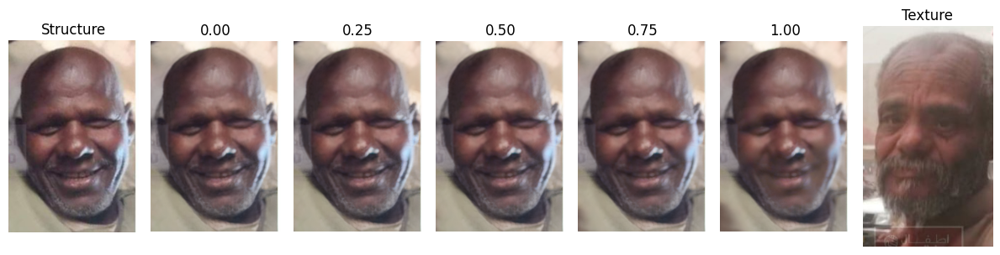

30it [00:16,  1.41it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png


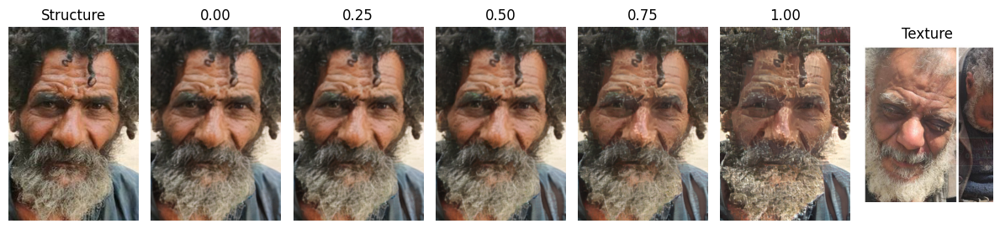

31it [00:17,  1.39it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_218.png


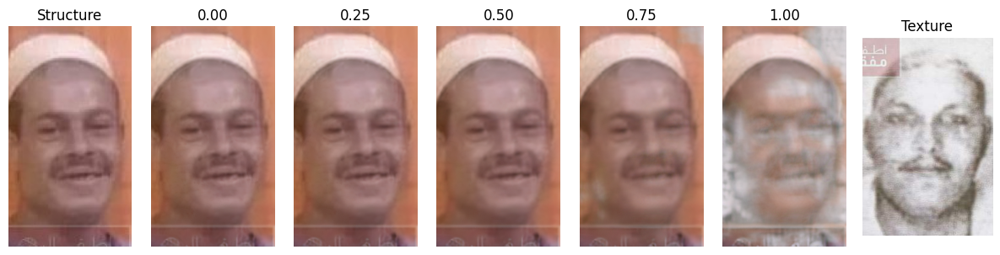

32it [00:18,  1.36it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_355.png


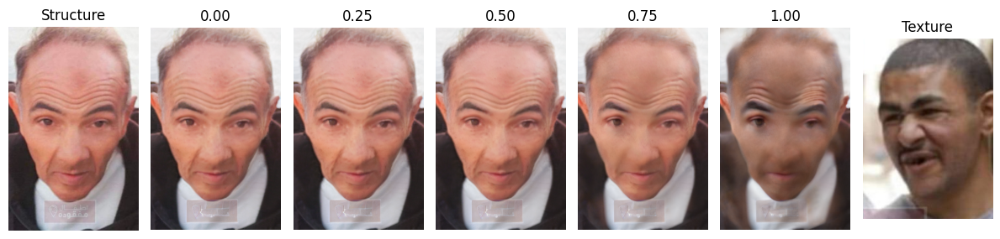

33it [00:19,  1.33it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_370.png


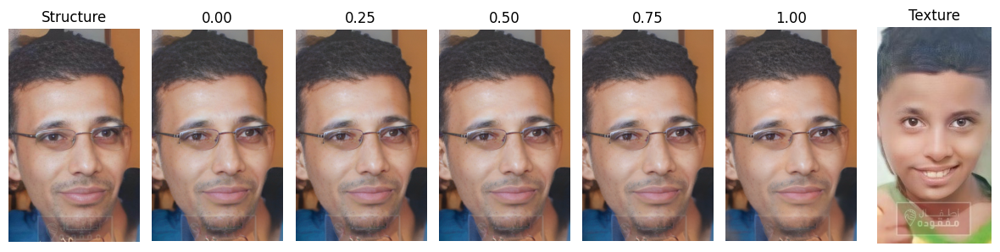

34it [00:20,  1.25it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_135.png


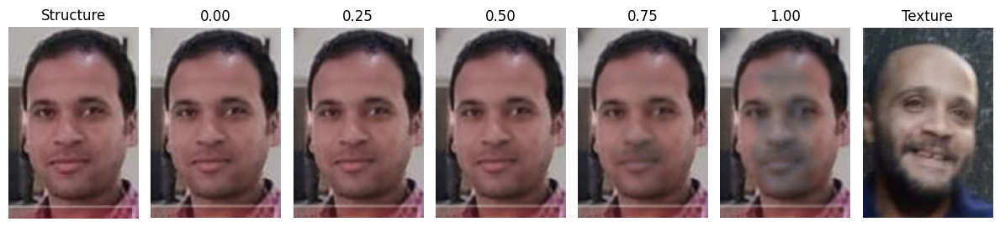

35it [00:20,  1.28it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_592.png


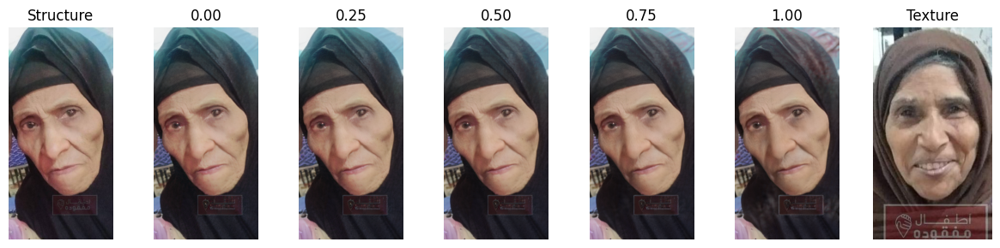

36it [00:21,  1.27it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_421.png


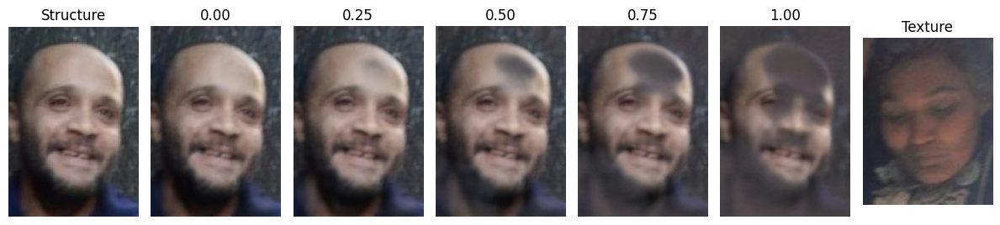

37it [00:22,  1.30it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_603.png
Missing person's file not found or no valid candidate image found!
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_87.png


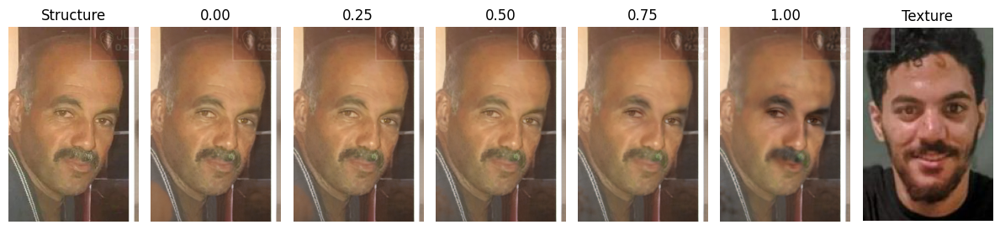

39it [00:23,  1.64it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_332.png


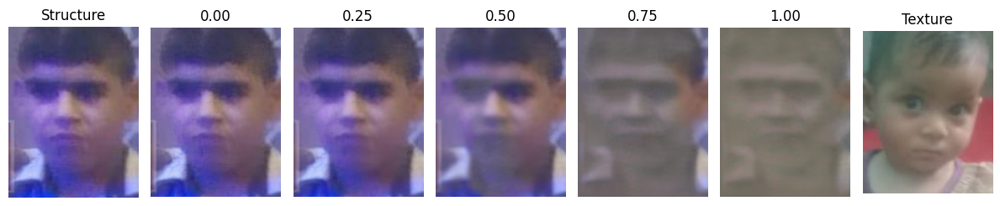

40it [00:23,  1.60it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_202.png


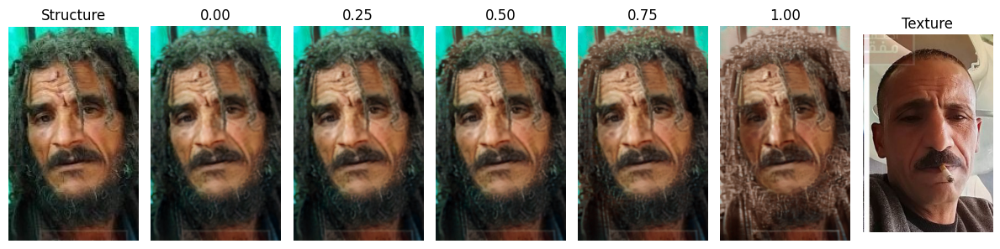

41it [00:24,  1.49it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_306.png


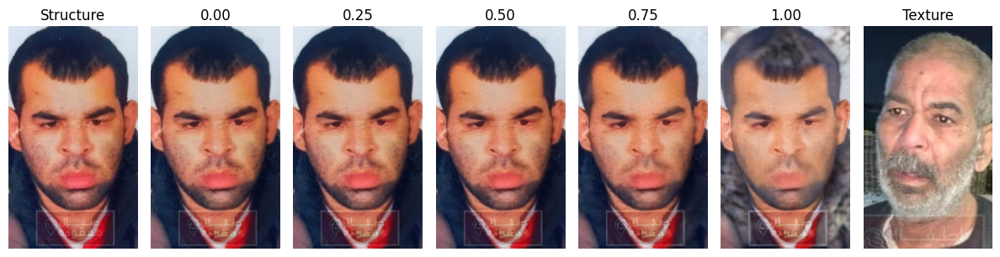

42it [00:25,  1.38it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png


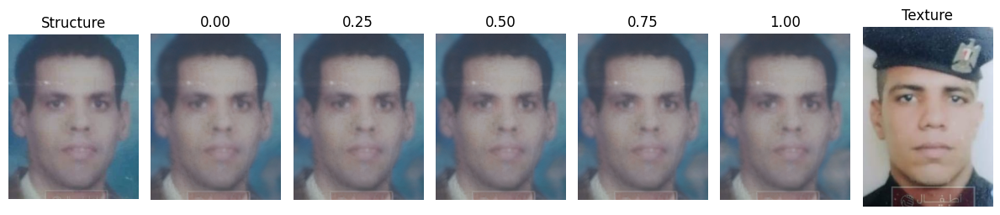

43it [00:26,  1.37it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_655.png


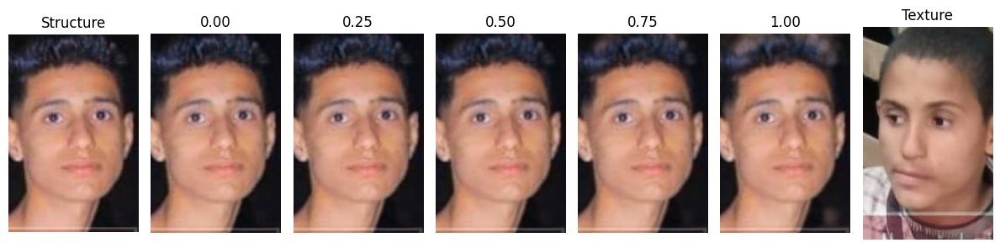

44it [00:26,  1.36it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_274.png


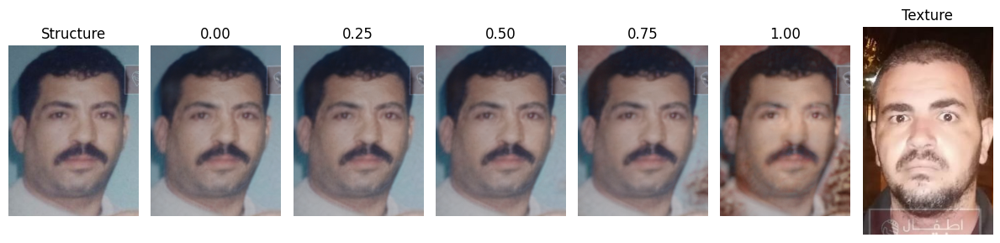

45it [00:27,  1.38it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_634.png


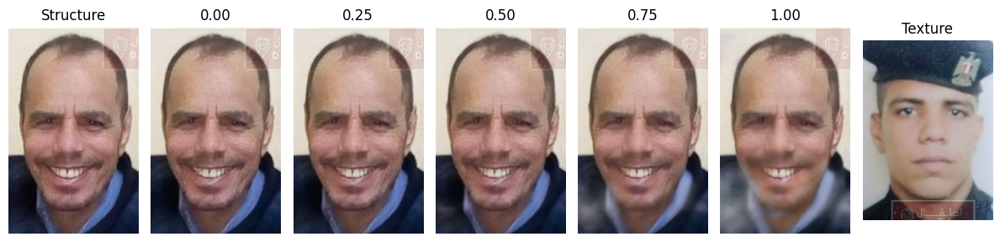

46it [00:28,  1.37it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_13.png


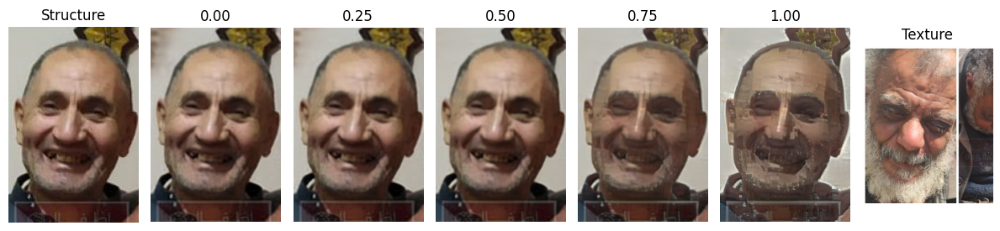

47it [00:29,  1.32it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_114.png


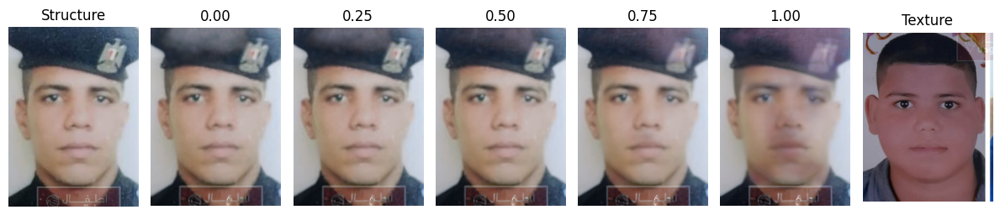

48it [00:29,  1.34it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_232.png


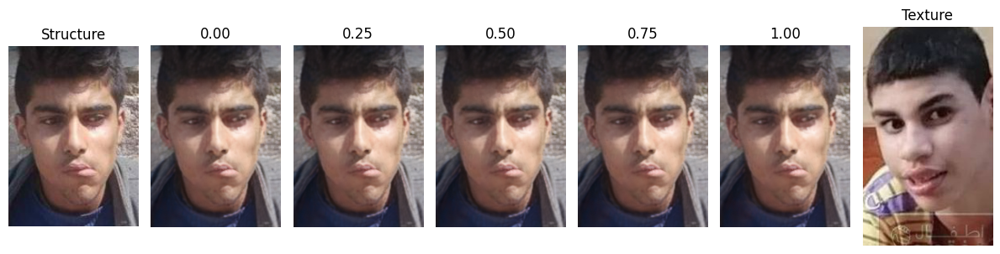

49it [00:30,  1.37it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_560.png


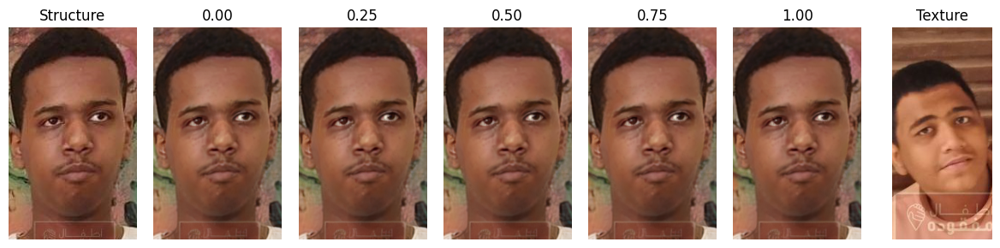

50it [00:31,  1.36it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_374.png


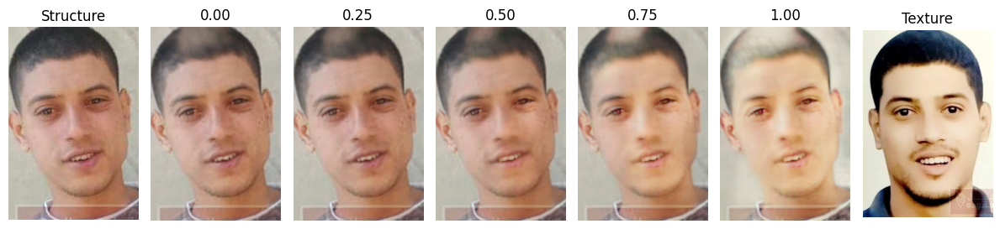

51it [00:32,  1.31it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_649.png
Missing person's file not found or no valid candidate image found!
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_227.png


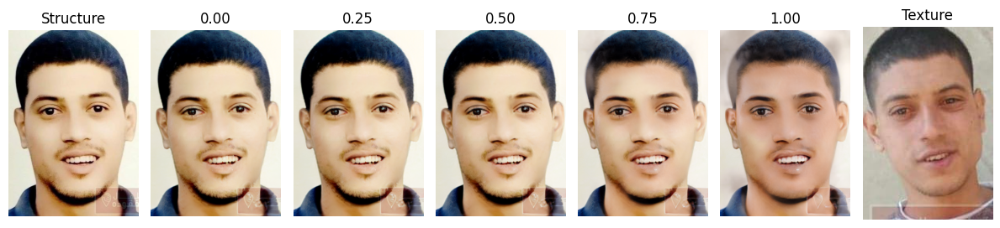

53it [00:32,  1.76it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_202.png


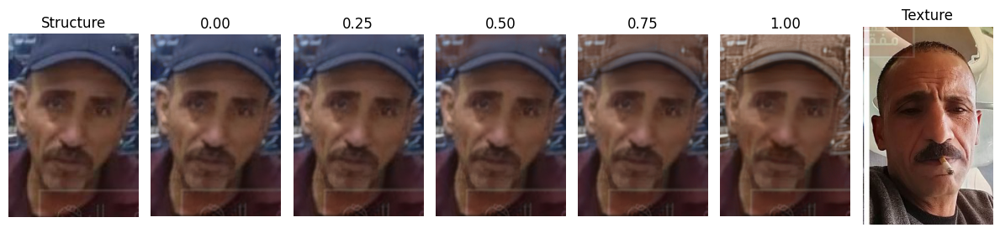

54it [00:33,  1.65it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_517.png


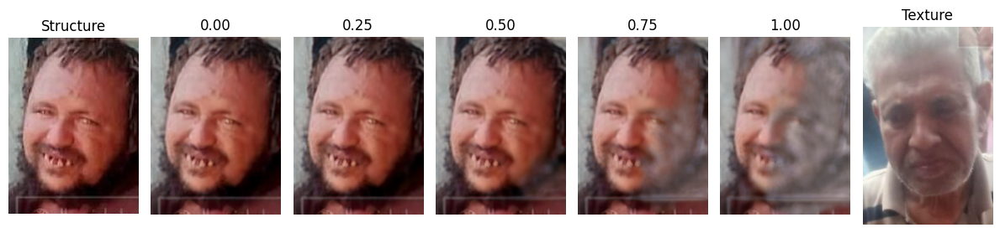

55it [00:34,  1.60it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_749.png


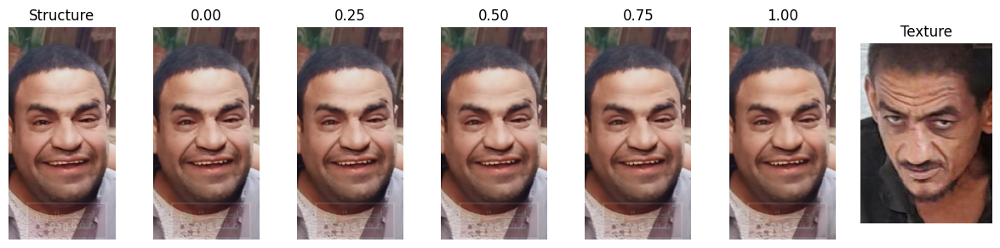

56it [00:35,  1.44it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_340.png


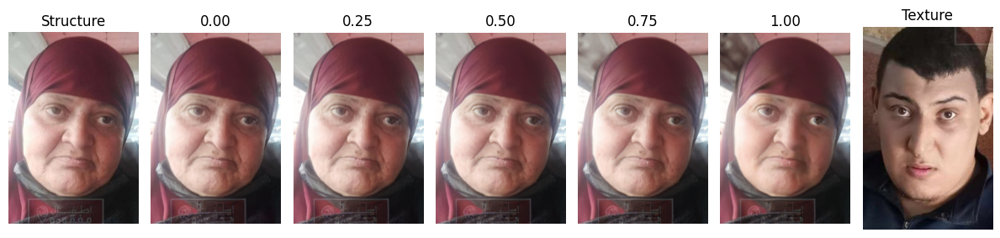

57it [00:35,  1.37it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_762.png
Missing person's file not found or no valid candidate image found!
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_25.png


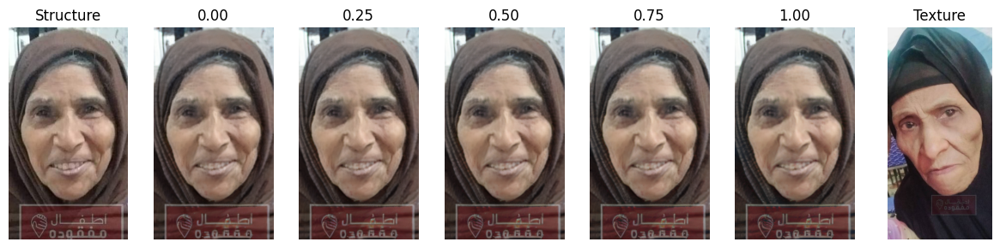

59it [00:36,  1.73it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_482.png


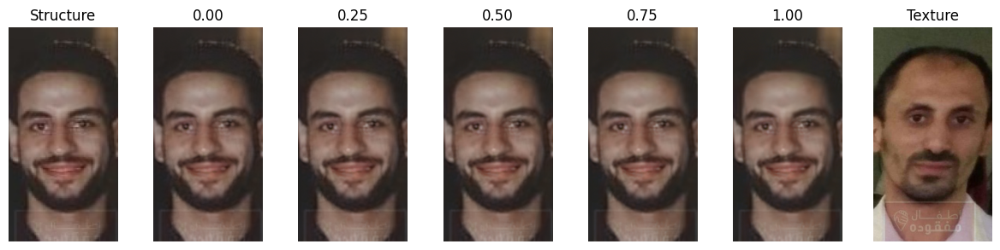

60it [00:37,  1.59it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_152.png


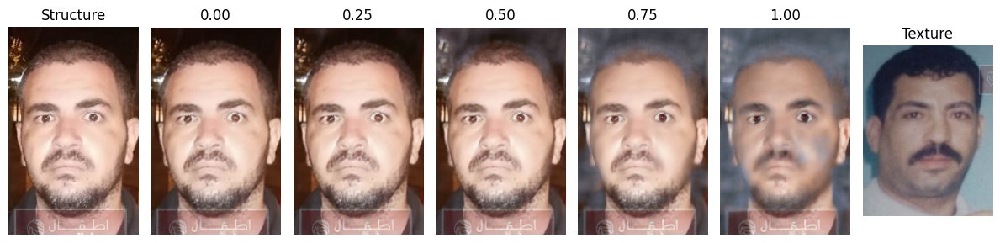

61it [00:38,  1.52it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_336.png


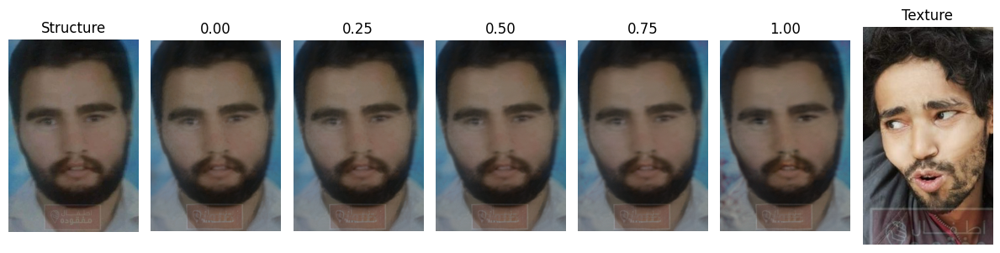

62it [00:39,  1.41it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_779.png


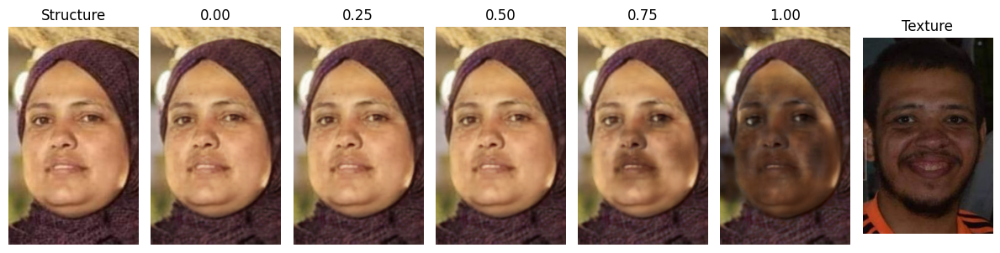

63it [00:39,  1.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_422.png


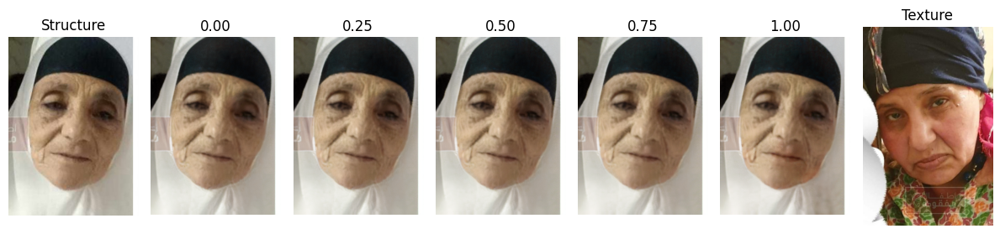

64it [00:40,  1.38it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/john_doe_image_571.png


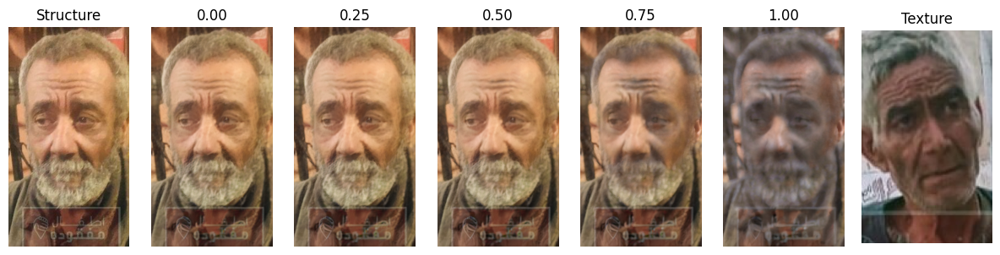

65it [00:41,  1.35it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_100.png
Missing person's file not found or no valid candidate image found!
/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_460.png


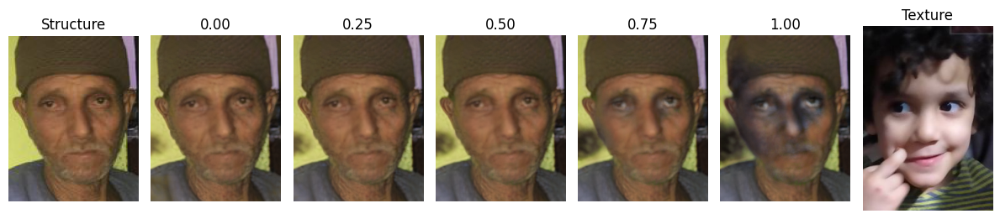

67it [00:42,  1.73it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_670.png


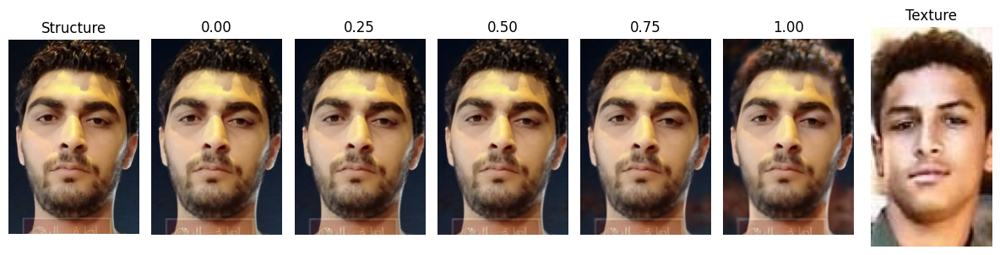

68it [00:42,  1.61it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_121.png


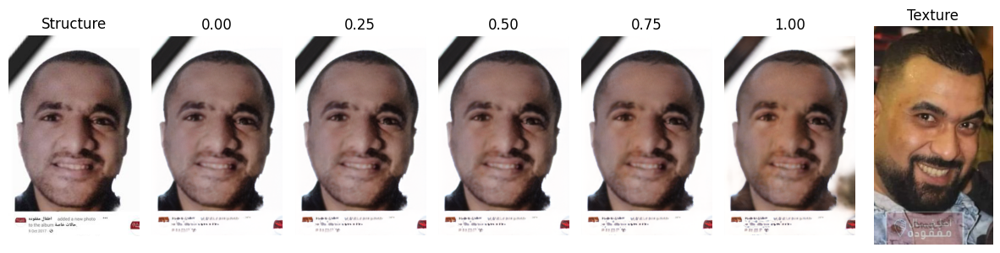

69it [00:43,  1.53it/s]

/projectnb/sparkgrp/ml-atfal-mafkoda-grp/missing_children_johndoe_reunited_images_bounding_box/reunited_image_114.png


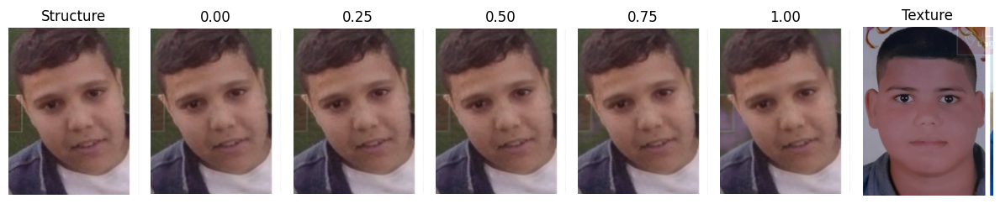

70it [00:44,  1.58it/s]

Missing Structures: 0
Missing Textures: 9
Missing Results: 1


In [9]:
missing_structure = 0
missing_texture = 0
missing_results = 0
def display_images(image_folder, image_prefix, image_suffix, input_structure_image, input_texture_image):
    global missing_structure, missing_texture, missing_results
    # Create a figure and grid layout
    fig = plt.figure(figsize=(12, 3))
    gs = gridspec.GridSpec(1, 7)  # 1 row, 7 columns

    # Display the input_structure_image
    try: 
        ax1 = plt.subplot(gs[0, 0])
        ax1.imshow(Image.open(input_structure_image))
        ax1.axis('off')
        ax1.set_title('Structure')
    except FileNotFoundError:
        print(f"File not found: {input_structure_image}")
        missing_structure += 1

    # Display the interpolated images
    try:
        for i in range(5):
            image_path = os.path.join(image_folder, f"{image_prefix}_{image_suffix}_{i*0.25:.2f}.png")
            ax = plt.subplot(gs[0, i+1])
            ax.imshow(Image.open(image_path))
            ax.axis('off')
            ax.set_title(f"{i*0.25:.2f}")
    except FileNotFoundError:
        print(f"File not found: {image_prefix}_{image_suffix}_{i*0.25:.2f}.png")
        missing_texture += 1

    # Display the input_texture_image
    try:
        ax7 = plt.subplot(gs[0, 6])
        ax7.imshow(Image.open(input_texture_image))
        ax7.axis('off')
        ax7.set_title('Texture')
    except FileNotFoundError:
        print(f"File not found: {input_texture_image}")
        missing_results += 1
    
    plt.tight_layout()
    plt.show()

for index, row in tqdm(df.iterrows()):
    
    missing_filename = row['missing_filename'] 
    input_structure_image = candidate_directory + missing_filename
    directory_exists = os.path.exists(os.path.dirname(input_structure_image))
    best_match_filename = row['best_match']
    input_texture_image = image_directory + best_match_filename
    print(input_texture_image)
    directory_exists = os.path.exists(os.path.dirname(input_texture_image)) and directory_exists
    if not directory_exists or not row['valid_found']:
        print("Missing person's file not found or no valid candidate image found!")
    else:
        image_folder = "/projectnb/sparkgrp/ml-atfal-mafkoda-grp/swapping-autoencoder-pytorch/results/ffhq512_pretrained/simpleswapping/"
        image_prefix = row['missing_filename'].replace('.png', '')
        image_suffix = row['best_match'].replace('.png', '')
        input_structure_image = input_structure_image
        input_texture_image = input_texture_image
        
        display_images(image_folder, image_prefix, image_suffix, input_structure_image, input_texture_image)

print(f"Missing Structures: {missing_structure}")
print(f"Missing Textures: {missing_texture}")
print(f"Missing Results: {missing_results}")